# Version 1

### testing superpixel

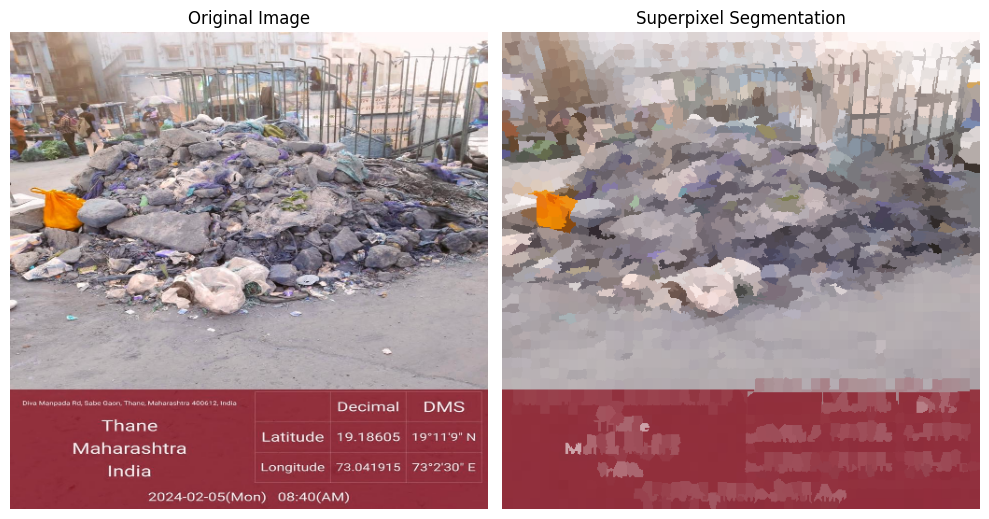

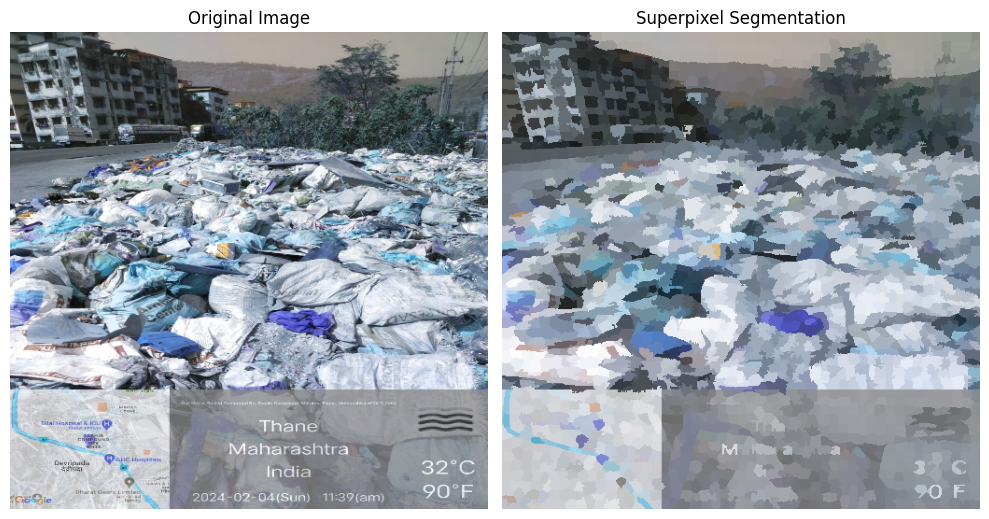

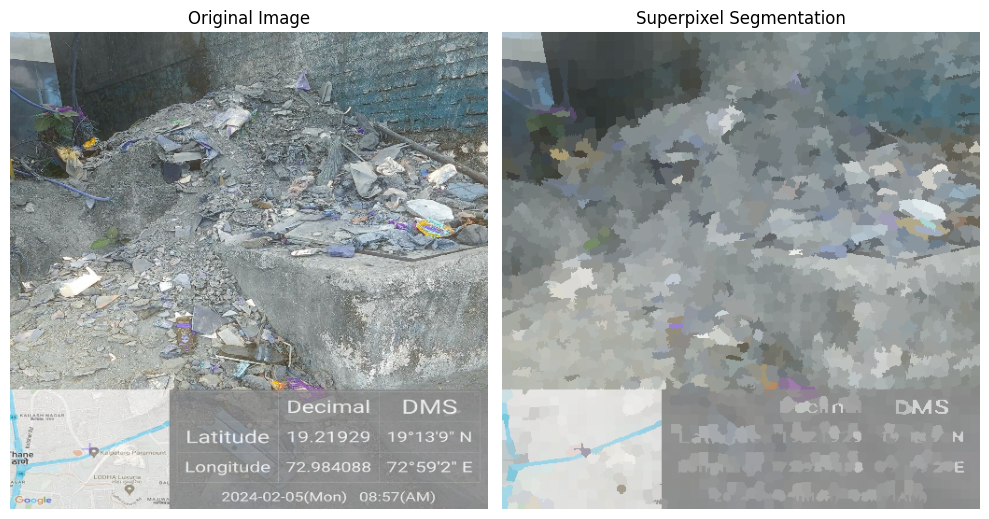

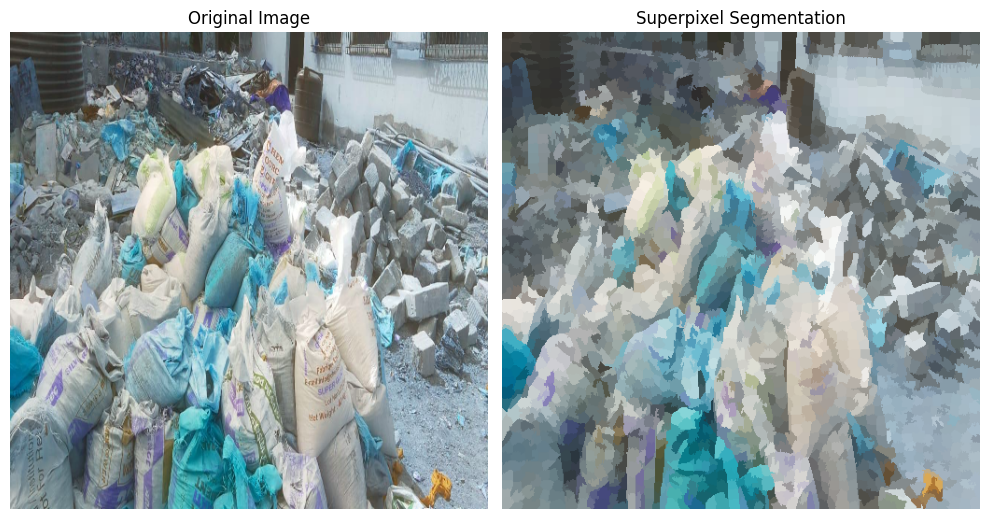

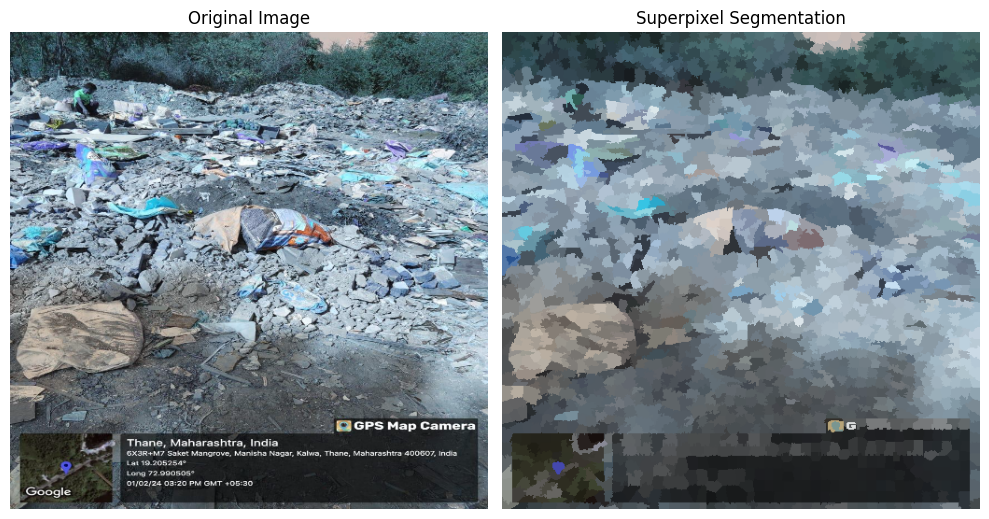

...

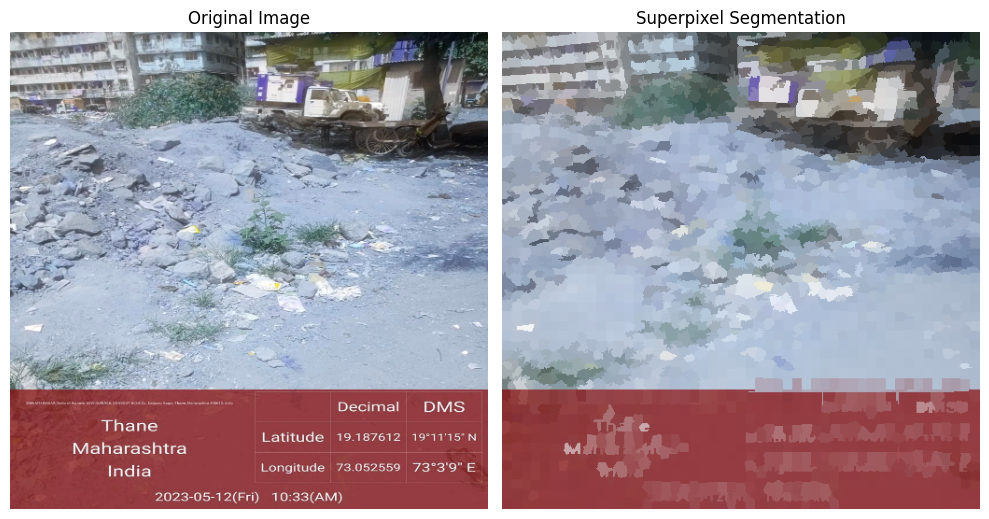

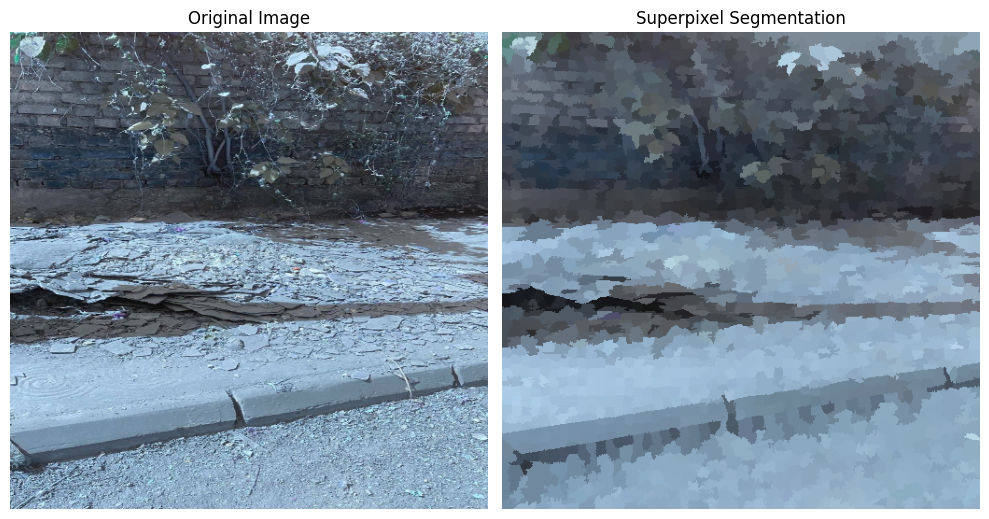

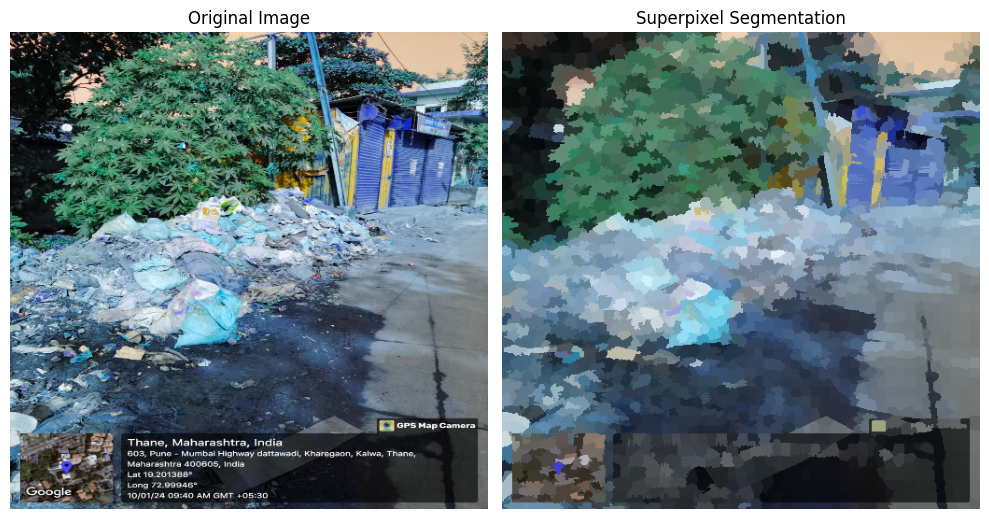

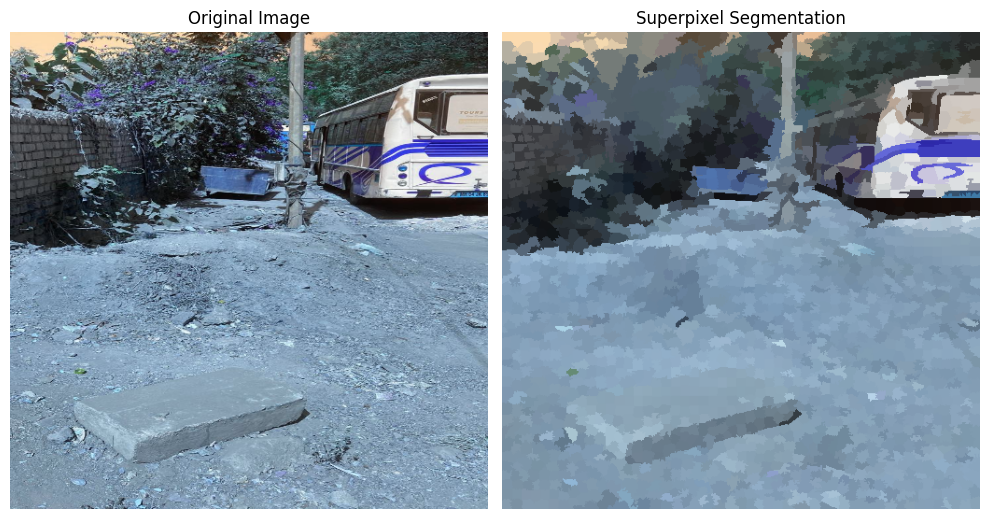

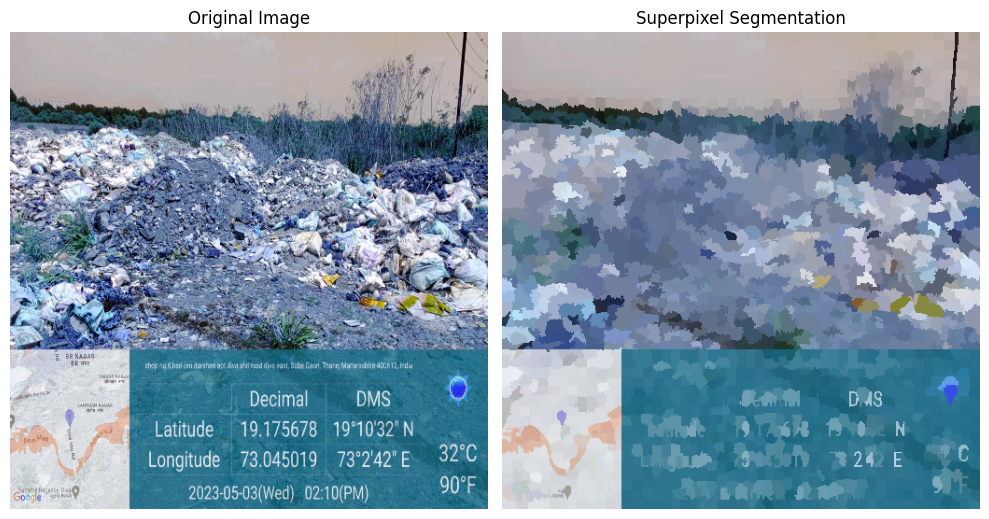

In [1]:
import numpy as np
import os
import cv2
from skimage.segmentation import slic
import matplotlib.pyplot as plt
from skimage.color import label2rgb

def image_to_superpixel(img, n_segments=2500,compactness=10,display=False):
    
    img_resized = cv2.resize(img, (512, 512))

    # Apply SLIC superpixel segmentation
    superpixels = slic(img_resized, n_segments=n_segments, compactness=compactness)

    # Convert superpixel labels to an RGB image for visualization
    superpixels_rgb = label2rgb(superpixels, img_resized, kind='avg')

    if display:
        # Plot the superpixel segmentation
        plt.figure(figsize=(10, 200))
        plt.subplot(1,2,1)
        plt.imshow(img_resized)
        plt.title('Original Image')
        plt.axis('off')
        plt.subplot(1,2,2)
        plt.imshow(superpixels_rgb)
        plt.title('Superpixel Segmentation')
        plt.axis('off')
        plt.tight_layout()
        plt.show()


# Load and preprocess image
image_dir = 'train_images'
image_list=[]

for img in os.listdir(image_dir):
    image_path = os.path.join(image_dir,img)
    if os.path.exists(image_path):
        image_list.append(image_path)

for image_path in image_list:
    image = cv2.imread(image_path)
    image_to_superpixel(image, display=True)



### Adaptive Superpixels

In [23]:
import importlib
import custom
importlib.reload(custom)
from custom import *
import os
import cv2
# Load and preprocess image
image_dir = 'train_images'
image_list=[]

for img in os.listdir(image_dir):
    image_path = os.path.join(image_dir,img)
    if os.path.exists(image_path):
        image_list.append(image_path)

for image_path in image_list:
    image = cv2.imread(image_path)
    super=adaptive_slic(image, n_segments=5000, compactness=10,display=0, return_type='image')
    folder="adaptive_superpixeled_images"
    save_images(super, folder, image_path)


### Applying Canny edge

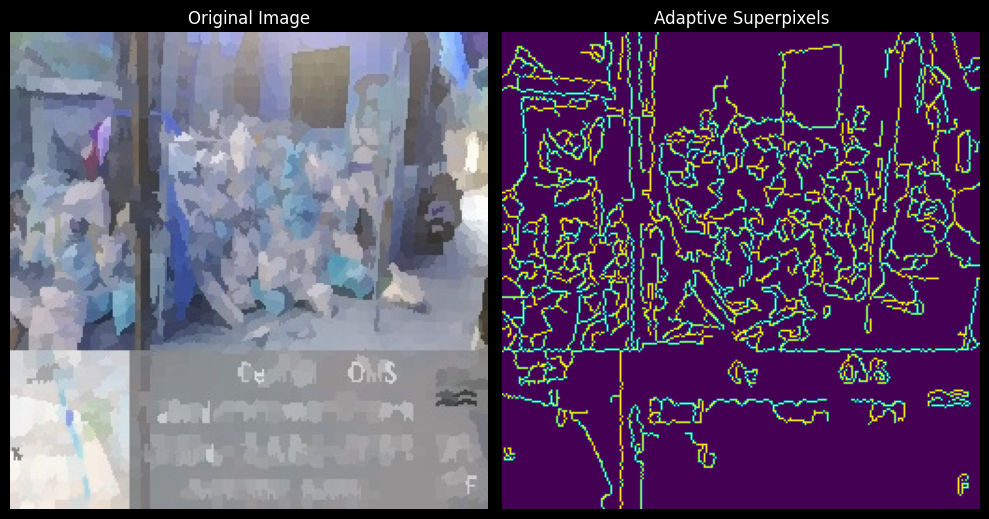

In [9]:
import os
import cv2
t_lower = 50  # Lower Threshold 
t_upper = 200  # Upper threshold 
sup_list=[]

image_dir='adaptive_superpixeled_images'
for img in os.listdir(image_dir):
    image_path = os.path.join(image_dir,img)
    if os.path.exists(image_path):
        sup_list.append(image_path)


image=cv2.imread(sup_list[5])
# Applying the Canny Edge filter 
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
edge = cv2.Canny(gray, t_lower, t_upper) 

display_image(edge, image, True)

### Segment Trash

#### v1

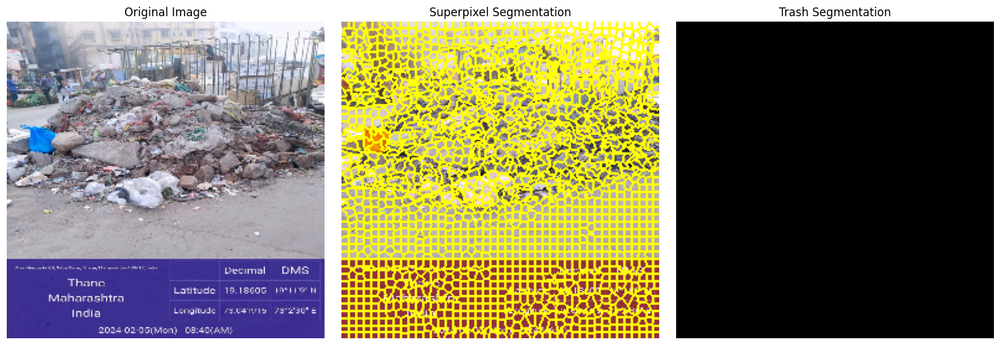

In [1]:
import numpy as np
import cv2
from skimage.segmentation import slic, mark_boundaries
from skimage.color import label2rgb
import matplotlib.pyplot as plt
import importlib
import custom
importlib.reload(custom)
from custom import *

resize=(256,256)

def segment_trash(superpixels, original_image, resize=(256,256)):
    image_resized = cv2.resize(original_image, resize)
    unique_labels = np.unique(superpixels)
    trash_mask = np.zeros_like(superpixels, dtype=np.uint8)

    for label in unique_labels:
        superpixel_region = (superpixels == label)
        boundary = cv2.Canny(superpixel_region.astype(np.uint8) * 255, 100, 200)
        
        if np.sum(boundary) > np.sum(superpixel_region) * 0.1:
            trash_mask[superpixel_region] = 255  # Mark as trash

    return trash_mask

# Load and preprocess image
image = cv2.imread('train_images/IMG-20240618-WA0003.jpg')
# Apply ASLIC superpixel segmentation
superpixels = adaptive_slic(image, n_segments=2000,resize=resize, compactness=10,display=0, return_type='label')

# Segment trash areas
trash_mask = segment_trash(superpixels, image, resize=resize)

img_resized=cv2.resize(image, resize)

# Visualize the results
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))

# Original image
ax1.imshow(cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB))
ax1.set_title('Original Image')
ax1.axis('off')

# Superpixel boundaries
ax2.imshow(mark_boundaries(img_resized, superpixels))
ax2.set_title('Superpixel Segmentation')
ax2.axis('off')

# Trash segmentation
ax3.imshow(trash_mask, cmap='gray')
ax3.set_title('Trash Segmentation')
ax3.axis('off')

plt.tight_layout()
plt.show()

#### v2

In [19]:
import numpy as np
import cv2
from skimage.segmentation import slic, mark_boundaries
from skimage.color import label2rgb
import matplotlib.pyplot as plt
import importlib
import custom
importlib.reload(custom)
from custom import *

resize=(256,256)

# Function to filter out green areas (vegetation)
def filter_green_areas(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green = np.array([35, 40, 40])
    upper_green = np.array([85, 255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    return mask

# Function to segment trash areas based on superpixel properties and edge density
def segment_trash(superpixels, edges, green_mask):
    unique_labels = np.unique(superpixels)
    trash_mask = np.zeros_like(superpixels, dtype=np.uint8)

    for label in unique_labels:
        superpixel_region = (superpixels == label)
        edge_density = np.sum(edges[superpixel_region])

        if edge_density > 0.1 * np.sum(superpixel_region) and np.sum(green_mask[superpixel_region]) < 0.5 * np.sum(superpixel_region):
            trash_mask[superpixel_region] = 255  # Mark as trash

    return trash_mask

# Load and preprocess image
image = cv2.imread('train_images/IMG-20240618-WA0003.jpg')

def superedges(image):
    resize=(256,256)
    img_resized = cv2.resize(image, resize)
    # Apply edge detection to the entire resized image
    gray_img = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    edges = cv2.Canny(gray_img, 100, 150)

    # Filter out green areas (vegetation)
    green_mask = filter_green_areas(img_resized)

    # Apply ASLIC superpixel segmentation
    superpixels = adaptive_slic(image, n_segments=2000,resize=resize, compactness=10,display=0, return_type='label')

    # Segment trash areas based on edge density within superpixels and excluding green areas
    trash_mask = segment_trash(superpixels, edges, green_mask)

    # Visualize the results
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))

    # Original image
    ax1.imshow(cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image')
    ax1.axis('off')

    # Superpixel boundaries
    ax2.imshow(mark_boundaries(img_resized, superpixels))
    ax2.set_title('Superpixel Segmentation')
    ax2.axis('off')

    # Trash segmentation
    ax3.imshow(trash_mask, cmap='gray')
    ax3.set_title('Trash Segmentation')
    ax3.axis('off')

    plt.tight_layout()
    plt.show()

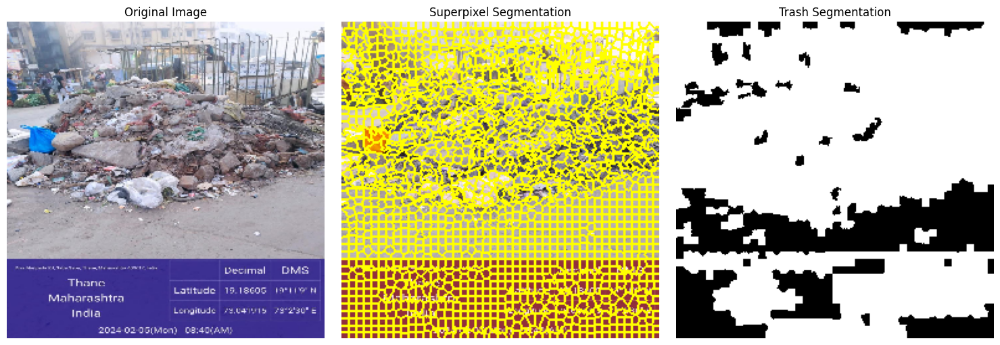

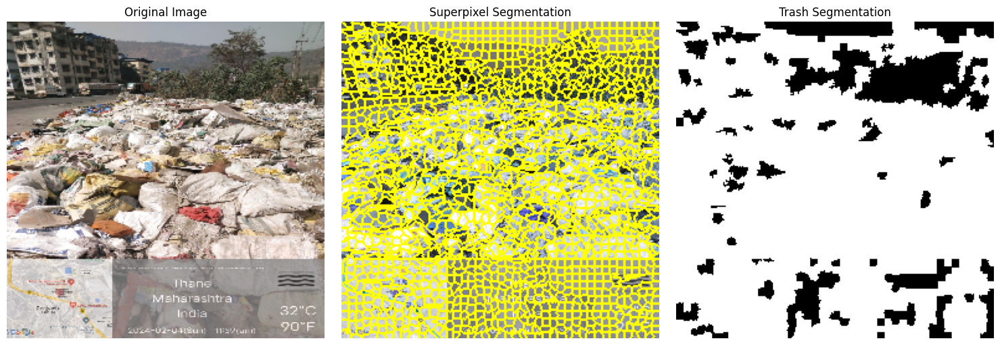

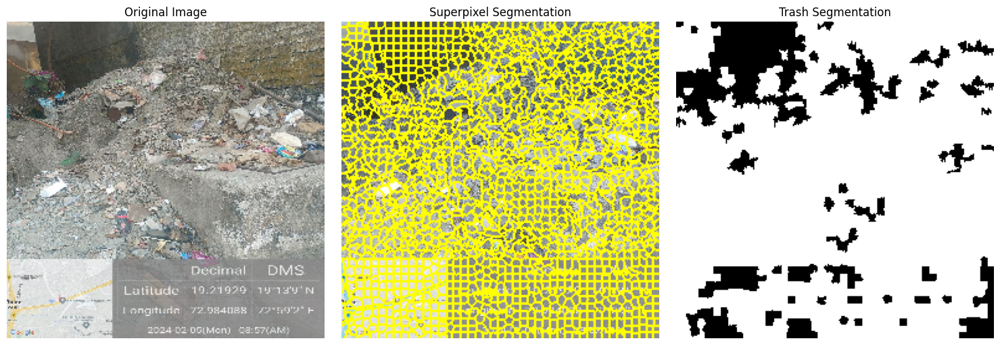

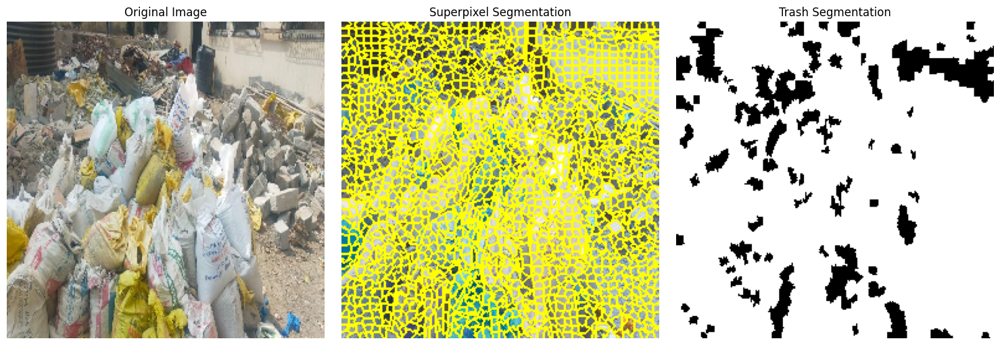

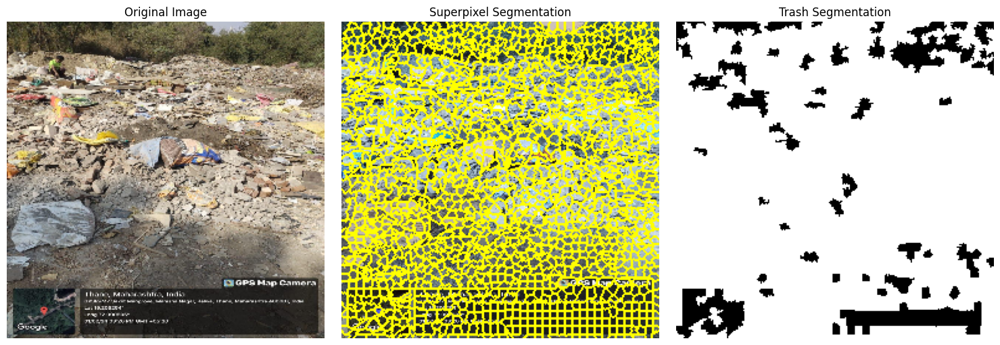

...

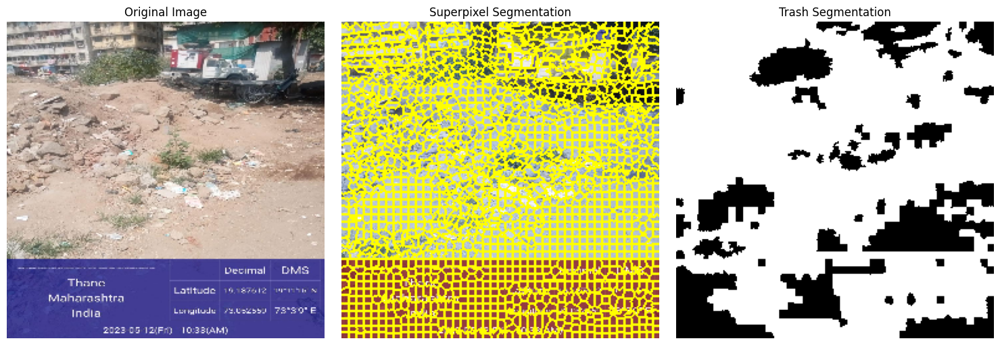

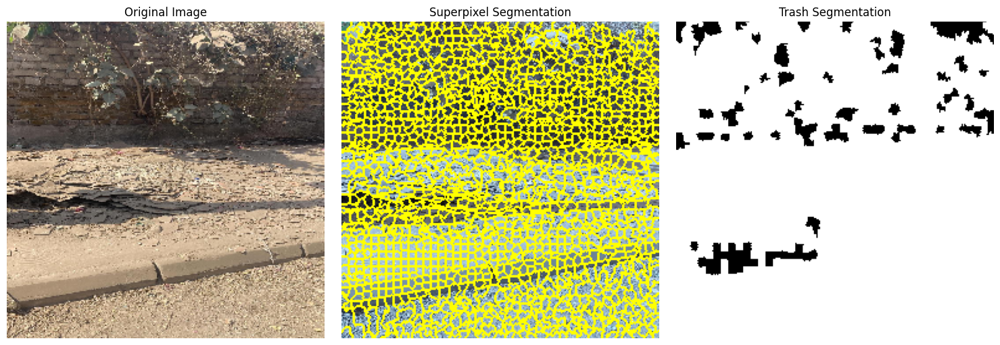

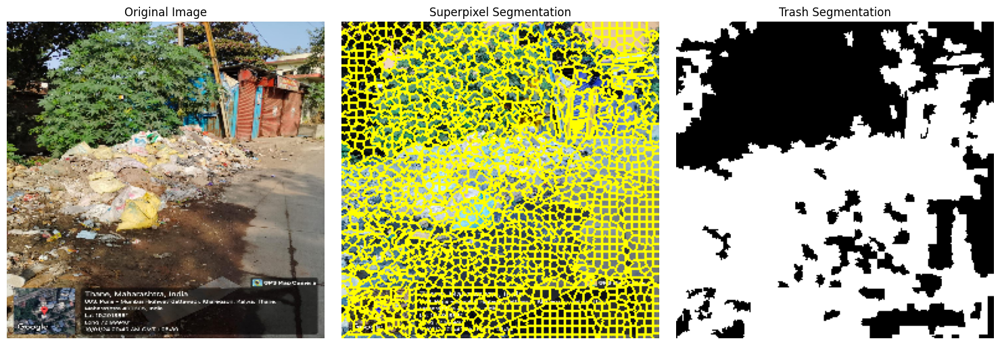

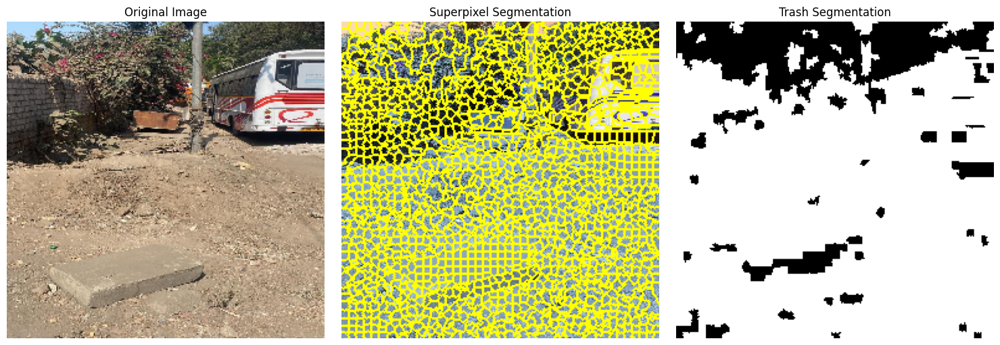

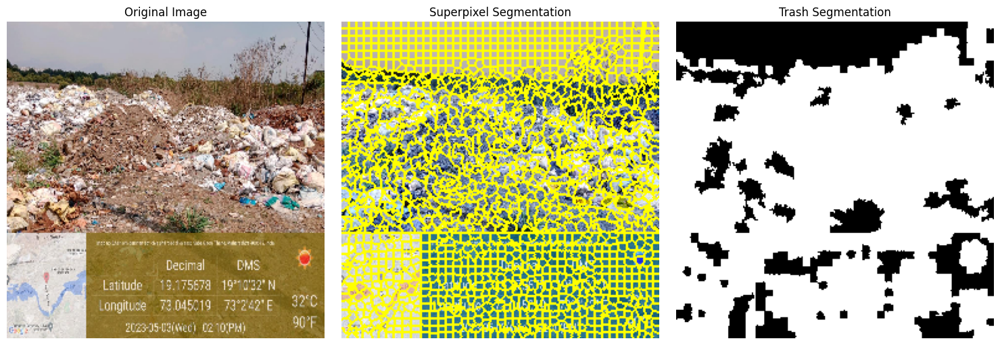

In [20]:
import os
import cv2
# Load and preprocess image
image_dir = 'train_images'
image_list=[]

for img in os.listdir(image_dir):
    image_path = os.path.join(image_dir,img)
    if os.path.exists(image_path):
        image_list.append(image_path)


for image in image_list:
    superedges(cv2.imread(image))